In [ ]:
from google.colab import files
files.upload()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import re
from difflib import get_close_matches
import numpy as np
import seaborn as sns
import missingno as ms
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

In [ ]:
lima_2019 = pd.read_csv('drive/MyDrive/Colab Notebooks/PROYECTO/casas_2019.csv')
lima_2020 = pd.read_csv('drive/MyDrive/Colab Notebooks/PROYECTO/casas_2020.csv')

In [ ]:
# Obtener las columnas de cada DataFrame
columnas_2019 = set(lima_2019.columns)
columnas_2020 = set(lima_2020.columns)

# Ver las columnas que están en 2019 pero no en 2020
columnas_2019_no_en_2020 = columnas_2019.difference(columnas_2020)

# Ver las columnas que están en 2020 pero no en 2019
columnas_2020_no_en_2019 = columnas_2020.difference(columnas_2019)

print("Columnas en 2019 pero no en 2020:", columnas_2019_no_en_2020)
print("Columnas en 2020 pero no en 2019:", columnas_2020_no_en_2019)

Columnas en 2019 pero no en 2020: {'Provincia', 'Ubicacion'}
Columnas en 2020 pero no en 2019: {'Barrio', 'Ciudad', 'MONEDA'}


limpieza de cada csv para poder unirlos

Primero cambieramemos el nombre de las columnas para poder unirlos


In [ ]:
lima_2019.sample(n=3, random_state=100)
lima_2020.sample(n=3, random_state=100)

,latitud,longitud,Direccion,Descripcion,Barrio,Ciudad,Precio,Area_total,Area_constr,NroBanios,Cocheras,Dormitorios,Antiguedad,MONEDA
6763,12.082120,76.958614,Altura DE AV. LA Fontana CON EL Corregidor - L...,"Linda casa en condominio de 7 casas, en zona e...",NaN,Lima,S/ 1179290,243.0,243.0,2.0,2.0,3.0,24.0,S/
4084,12.078915,76.928020,Av BELLO HORIZONTE S/N,BAJO DE PRECIO !!!!!! LINDA CASA DE ESTRENO MU...,La Molina,Lima,USD 830000,600.0,363.0,5.0,4.0,5.0,4.0,USD
2115,12.112767,76.985908,chacarilla del estanque,"Se vende hermosa casa en San Borja, Calle Buen...",San Borja,Lima,S/ 5040000,796.0,796.0,4.0,3.0,4.0,10.0,S/


In [ ]:
# tenemos que cambiar  'Ubicacion' por 'Distrito' 2019
# cambiamos barrio y ciudad por distrito y provincia
lima_2019.rename(columns={'Ubicacion':'Distrito'},inplace=True)
lima_2020.rename(columns={'Barrio':'Distrito','Ciudad':'Provincia'},inplace=True)

#UNIMOS LAS 2 DATAFRAME
lima_data=pd.concat([lima_2019,lima_2020],ignore_index=True)

In [ ]:
lima_data.shape

(15523, 14)

In [ ]:
#Eliminar duplicados de mi data
lima_data=lima_data.replace(r'^\s*$', np.nan, regex=True)
lima_data = lima_data.drop_duplicates()

In [ ]:
lima_data.shape

(14179, 14)

In [ ]:
#ELIMINAMOS COLUMNAS QUE NO SERAN UTILES PARA NUESTRO MODELO
lima_data.drop(columns=['Descripcion', 'Direccion','MONEDA'], inplace=True)
#ELIMINAR -LIMA DE LOS DISTRITOS
lima_data['Distrito']=lima_data['Distrito'].str.replace('-Lima','',regex=False)

In [ ]:
#COLOCAMOS TODOS LO REGISTROS CON PROVINCIA LIMA
lima_data['Provincia']='Lima'

In [ ]:
#VEMOS TODOS LOS DISTRITOS
lima_data['Distrito'].unique()


array(['LaMolina', 'Lurigancho', 'Asia', 'SantiagoDeSurco', 'SanBorja',
       'Lince', 'VillaElSalvador', 'Pachacamac', 'SanJuanDeMiraflores',
       'JesusMaria', 'Huanchaco-LaLibertad', 'Carabayllo', 'Mala',
       'Lurin', 'SanJuanDeLurigancho', 'Miraflores', 'SanMartinDePorres',
       'SanIsidro', 'SanMiguel', 'Chorrillos', 'Cieneguilla',
       'VillaMariaDelTriunfo', 'Iquitos-Loreto', 'Chaclacayo', 'Brenia',
       'CerroAzul', 'MagdalenaDelMar', 'Ate', 'LaVictoria', 'LosOlivos',
       'PuentePiedra', 'Bellavista-Callao', 'Ventanilla-Callao',
       'SanLuis', 'PuebloLibre', 'Ancon', 'Comas', 'Barranco',
       'SanAntonio', 'CercadoDeLima', 'Callao-Callao', 'LaPerla-Callao',
       'Chiclayo-Lambayeque', 'Piura-Piura',
       'VictorLarcoHerrera-LaLibertad', 'SanBartolo', 'Pisac-Cusco',
       'Castilla-Piura', 'Surquillo', 'ElAgustino', 'Chilca', 'Rimac',
       'Pucusana', 'Huancayo-Junin', 'Pimentel-Lambayeque',
       'ChinchaAlta-Ica', 'Huaraz-Ancash', 'SantaMariaDelMar'

In [ ]:
#CONVERTIMOS DISTRITO Y PROVINCIA A STRING
lima_data['Distrito'] = lima_data['Distrito'].astype(str)
lima_data['Provincia'] = lima_data['Provincia'].astype(str)

In [ ]:
#eliminamos datos que contengag caracteres especiales
#separamas las palabras por cada mayusvcula
lima_data = lima_data[~lima_data['Distrito'].str.contains('-', regex=False)]

lima_data['Distrito'] = lima_data['Distrito'].apply(lambda x: re.sub(r'(?<=[a-z])(?=[A-Z])', ' ', x))
lima_data.sample(n=5, random_state=100)

<ipython-input-14-fa6ab921fe7b>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  lima_data['Distrito'] = lima_data['Distrito'].apply(lambda x: re.sub(r'(?<=[a-z])(?=[A-Z])', ' ', x))


,latitud,longitud,Distrito,Provincia,Precio,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Antiguedad
5400,-12.075639,-76.911006,La Molina,Lima,1180000.0,387.00 m2,600.00 m2,5.0,2.0,4,9.0
2358,-12.304296,-76.848058,Punta Hermosa,Lima,119000.0,220.00 m2,250.00 m2,5.0,0.0,3,3.0
14770,12.142489,76.991033,Santiago de Surco,Lima,S/ 1097400,150.0,200.0,1.0,1.0,3.0,25.0
3708,-12.071631,-76.965053,La Molina,Lima,1450000.0,500.00 m2,1000.00 m2,5.0,4.0,4,1.0
692,-12.081242,-76.899002,La Molina,Lima,650000.0,500.00 m2,560.00 m2,5.0,4.0,5+,2.0


In [ ]:
#SE CORRIGE NOMBRES DE DISTRITOS
lima_data['Distrito'] = lima_data['Distrito'].str.strip().str.title()
correcciones = {
    'Brenia': 'Breña',
    'Santiago De Surco': 'Santiago de Surco',
    'Jesus Maria': 'Jesús María',
    'San Juan De Miraflores': 'San Juan de Miraflores',
    'San Juan De Lurigancho': 'San Juan de Lurigancho',
    'Lurigancho':'San Juan de Lurigancho',
    'San Martin De Porres': 'San Martín de Porres',
    'Villa Maria Del Triunfo': 'Villa María del Triunfo',
    'Magdalena Del Mar': 'Magdalena del Mar',
    'Cercado De Lima': 'Cercado de Lima',
    'Rimac': 'Rímac',
    'Sta.Cruz De Flores': 'Santa Cruz de Flores',
    'Lima Cercado': 'Cercado de Lima',
    'Chosica (Lurigancho)': 'Lurigancho',
    'Ate Vitarte': 'Ate',
    'Villa El Salvador': 'Villa El Salvador',
    'Magdalena Vieja': 'Magdalena del Mar'
}
lima_data['Distrito'] = lima_data['Distrito'].replace(correcciones)

In [ ]:
distritos_lima = [
    'La Molina', 'San Juan De Lurigancho', 'Santiago de Surco', 'San Borja', 'Lince',
    'Villa El Salvador', 'Pachacamac', 'San Juan de Miraflores', 'Jesús María',
    'Carabayllo', 'Lurín', 'San Juan de Lurigancho', 'Miraflores',
    'San Martín de Porres', 'San Isidro', 'San Miguel', 'Chorrillos', 'Cieneguilla',
    'Villa María del Triunfo', 'Chaclacayo', 'Breña', 'Magdalena del Mar', 'Ate',
    'La Victoria', 'Los Olivos', 'Puente Piedra', 'San Luis', 'Pueblo Libre',
    'Ancón', 'Comas', 'Barranco', 'Cercado de Lima', 'San Bartolo', 'Surquillo',
    'El Agustino', 'Rímac', 'Pucusana', 'Santa María del Mar', 'Punta Negra',
    'Punta Hermosa', 'Independencia', 'Santa Anita'
]

# Filtrar solo los distritos de Lima Metropolitana (sin Callao)
lima_data = lima_data[lima_data['Distrito'].isin(distritos_lima)]

# Mostrar resultado
print("Distritos filtrados (solo Lima Metropolitana):")
print(lima_data['Distrito'].unique())
print("Total de registros:", len(lima_data))

Distritos filtrados (solo Lima Metropolitana):
['La Molina' 'San Juan de Lurigancho' 'Santiago de Surco' 'San Borja'
 'Lince' 'Villa El Salvador' 'Pachacamac' 'San Juan de Miraflores'
 'Jesús María' 'Carabayllo' 'Miraflores' 'San Martín de Porres'
 'San Isidro' 'San Miguel' 'Chorrillos' 'Cieneguilla'
 'Villa María del Triunfo' 'Chaclacayo' 'Breña' 'Magdalena del Mar' 'Ate'
 'La Victoria' 'Los Olivos' 'Puente Piedra' 'San Luis' 'Pueblo Libre'
 'Comas' 'Barranco' 'Cercado de Lima' 'San Bartolo' 'Surquillo'
 'El Agustino' 'Rímac' 'Pucusana' 'Punta Negra' 'Punta Hermosa'
 'Independencia' 'Santa Anita' 'Lurín' 'Ancón']
Total de registros: 11314


In [ ]:
#CONVERTIR PRECIO DOALRES A SOLES Y ELIMANR EL "USD" DE LOS REGISTROS

TIPO_DE_CAMBIO = 3.5

lima_data['Precio'] = lima_data['Precio'].astype(str)

# Crear una copia del precio original (por si necesitas conservarlo)
lima_data['Precio_original'] = lima_data['Precio']

# Crear una columna temporal para detectar si contenía 'USD'
es_dolar = lima_data['Precio'].str.contains('USD', na=False)

# Extraer solo los números del precio
lima_data['Precio'] = lima_data['Precio'].str.extract(r'(\d+[\d,]*)')[0].str.replace(',', '').astype('float32')

# Convertir solo los que estaban en dólares
lima_data.loc[es_dolar, 'Precio'] = lima_data.loc[es_dolar, 'Precio'] * TIPO_DE_CAMBIO

In [ ]:
#ELIMINAR M2 DE LOS CAMPOS CON TAMAÑO
# para ello mprimero devemos convertir toda la columa a tipo str y lueo ya dale el formato correcto
lima_data['Area_total'] = lima_data['Area_total'].astype(str)
lima_data['Area_constr'] = lima_data['Area_constr'].astype(str)

lima_data['Area_total'] = lima_data['Area_total'].str.replace('m2', '', regex=False)
lima_data['Area_constr'] = lima_data['Area_constr'].str.replace('m2', '', regex=False)


In [ ]:
#normalizaremos cada columa con su tipo de datos  STR
lima_data['Distrito'] = lima_data['Distrito'].astype(str)
lima_data['Provincia'] = lima_data['Provincia'].astype(str)

In [ ]:
columnas_a_limpiar = ['Dormitorios', 'Antiguedad', 'Cocheras','NroBanios']


for col in columnas_a_limpiar:
    lima_data[col] = lima_data[col].astype(str).str.replace(r'[^0-9.]', '', regex=True)

In [ ]:
columanas_double=['Area_constr','Area_total','Precio']

def convertir_a_double(df, columnas):
    for col in columnas:
        df[col] = pd.to_numeric(df[col], errors='coerce')  # Limpiar
        df[col] = df[col].astype('float64')  # Convertir a entero permitiendo NaN
    return df

lima_data=convertir_a_double(lima_data,columanas_double)

In [ ]:
#creamos una funcion para poder darle formato  a las columnas de manera mas rapida
columnas_Conevertir=['NroBanios','Cocheras','Dormitorios','Antiguedad']

def convertir_a_entero(df, columnas):
    for col in columnas:
        df[col] = pd.to_numeric(df[col], errors='coerce')  # Asegura que los datos sean numéricos
        df[col] = df[col].astype('Int64')  # Convierte a entero que acepta NaN
    return df


lima_data=convertir_a_entero(lima_data,columnas_Conevertir)

In [ ]:
lima_data = lima_data.drop(columns=['Precio_original'] )

In [ ]:
lima_data.describe()

------------------------------------------------------------------------------------------------------LIMPIEZA PARTE 2 MAS IMPUTACIÓN----------------------------------------------------------------

In [ ]:
#CORRECCION
lima_data_v1 = pd.read_csv('drive/MyDrive/Colab Notebooks/PROYECTO/lima_data_v1.csv')


In [ ]:
lima_data_v1_copy = lima_data.copy()

In [ ]:
lima_data_v1_copy.describe()

,latitud,longitud,Precio,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Antiguedad
count,11240.000000,11246.000000,1.124800e+04,11173.000000,11187.000000,11193.0,10681.0,11155.0,10812.0
mean,-1.069049,-6.731539,2.335117e+06,398.740320,861.595419,3.828822,2.690853,4.263469,12.756382
std,12.047822,76.688112,2.437144e+07,1845.454695,10917.926988,1.733392,1.677768,1.849518,23.291881
min,-17.092263,-77.135902,1.000000e+00,1.000000,1.000000,1.0,0.0,1.0,1.0
25%,-12.092766,-76.973539,5.400000e+05,242.000000,240.000000,3.0,2.0,3.0,3.0
50%,-12.011428,-76.894600,1.150000e+06,335.000000,368.000000,4.0,2.0,4.0,4.0
75%,12.089571,76.972217,2.380000e+06,450.000000,750.000000,5.0,4.0,5.0,20.0
max,17.652780,155.582782,2.066250e+09,185000.000000,977175.000000,90.0,30.0,90.0,999.0


In [ ]:
##APLICAR FILTRO PARA LAS COLUMNAS Baños, Dormitorios y Cocheras
def filtrar_outliers_iqr_multicol(df, columnas_con_limites, q1,q3):
    df_filtrado = df.copy()
    for columna, (min_val, max_val) in columnas_con_limites.items():
        Q1 = lima_data_v1_copy[columna].quantile(q1)
        Q3 = lima_data_v1_copy[columna].quantile(q3)
        IQR = Q3 - Q1

        limite_inferior = Q1 - 1.5 * IQR
        limite_superior = Q3 + 1.5 * IQR

        # Aplicar límites lógicos si están definidos
        if min_val is not None:
            limite_inferior = max(limite_inferior, min_val)
        if max_val is not None:
            limite_superior = min(limite_superior, max_val)

        df_filtrado = df_filtrado[
            (df_filtrado[columna].isna()) |  # conserva los NaN
            ((df_filtrado[columna] >= limite_inferior) &
            (df_filtrado[columna] <= limite_superior))
        ]
    return df_filtrado

In [ ]:
q1 = 0.25
q3 = 0.85
#COLOCAMOS RANGO INFERIOR Y SUPERIOR
columnas_con_limites = {
    'NroBanios': (1, 10),
    'Cocheras': (0, 7),
    'Dormitorios': (1, 10)
}
#CORREMOS FUNCION
data_casas_filtrado_1 = filtrar_outliers_iqr_multicol(lima_data_v1_copy, columnas_con_limites, q1, q3)

<Axes: >

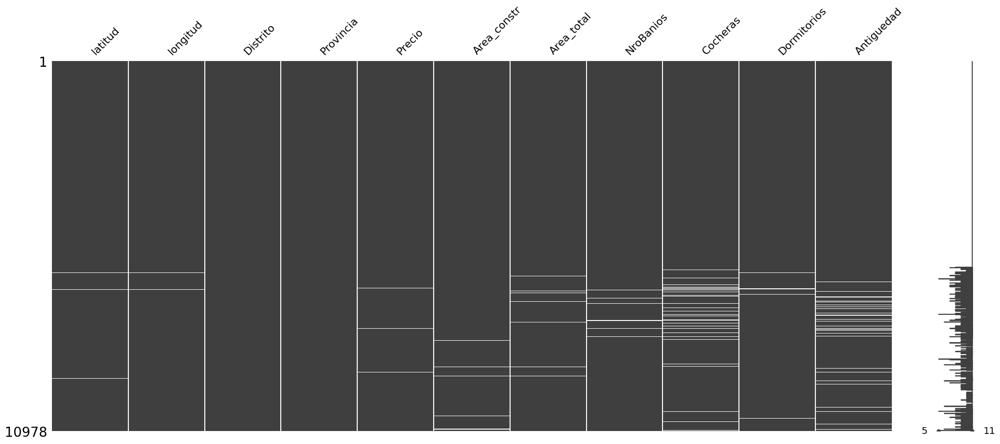

In [ ]:
ms.matrix(data_casas_filtrado_1)

In [ ]:
data_casas_filtrado_1.describe()

,latitud,longitud,Precio,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Antiguedad
count,10909.000000,10915.000000,1.091200e+04,10851.000000,10867.000000,10866.0,10401.0,10824.0,10500.0
mean,-1.465344,-9.256367,2.041583e+06,394.382601,753.448601,3.730536,2.600231,4.102088,12.327714
std,12.006870,76.424179,1.482014e+07,1869.279444,5899.534388,1.156785,1.420379,0.970135,22.388378
min,-17.092263,-77.135902,1.000000e+00,1.000000,1.000000,1.0,0.0,1.0,1.0
25%,-12.094013,-76.975795,5.300000e+05,241.900000,240.000000,3.0,2.0,3.0,3.0
50%,-12.050225,-76.903701,1.120000e+06,330.000000,361.000000,4.0,2.0,4.0,4.0
75%,12.088445,76.969607,2.300000e+06,450.000000,719.500000,5.0,4.0,5.0,20.0
max,17.652780,155.582782,1.368037e+09,185000.000000,543920.000000,8.0,7.0,8.0,999.0


In [ ]:
#APLICAR FILTRO PARA Area_constr Y Area_total

q1 = 0.20
q3 = 0.80
#COLOCAMOS RANGO INFERIOR Y SUPERIOR
columnas_con_limites = {
    'Area_constr': (40, None),
    'Area_total': (60, None)
}
#CORREMOS FUNCION
data_casas_filtrado_2 = filtrar_outliers_iqr_multicol(data_casas_filtrado_1, columnas_con_limites, q1, q3)

In [ ]:
#APLICAR FILTRO PARA PRECIO

q1 = 0.5
q3 = 0.95
#COLOCAMOS RANGO INFERIOR Y SUPERIOR
columnas_con_limites = {
    'Precio': (85000, None),
}
#CORREMOS FUNCION
data_casas_filtrado_3 = filtrar_outliers_iqr_multicol(data_casas_filtrado_2, columnas_con_limites, q1, q3)

In [ ]:
data_casas_filtrado_3.describe()

,latitud,longitud,Precio,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Antiguedad
count,10163.000000,10169.000000,1.016600e+04,10106.000000,10123.000000,10132.0,9703.0,10089.0,9775.0
mean,-1.347545,-8.498207,1.655457e+06,346.011563,501.736317,3.71289,2.537566,4.101695,12.525422
std,12.021045,76.515609,1.705947e+06,149.212740,386.129943,1.135643,1.350541,0.961783,22.904508
min,-17.092263,-77.133416,8.500000e+04,40.000000,60.000000,1.0,0.0,1.0,1.0
25%,-12.093468,-76.976937,5.300000e+05,240.000000,238.000000,3.0,2.0,3.0,3.0
50%,-12.051849,-76.905394,1.100000e+06,325.000000,350.000000,4.0,2.0,4.0,4.0
75%,12.088836,76.971737,2.200000e+06,427.000000,624.590000,5.0,4.0,5.0,20.0
max,17.652780,155.582782,1.330000e+07,890.000000,2185.000000,8.0,7.0,8.0,999.0


In [ ]:
data_casas_filtrado_3.shape

(10230, 11)

<Axes: >

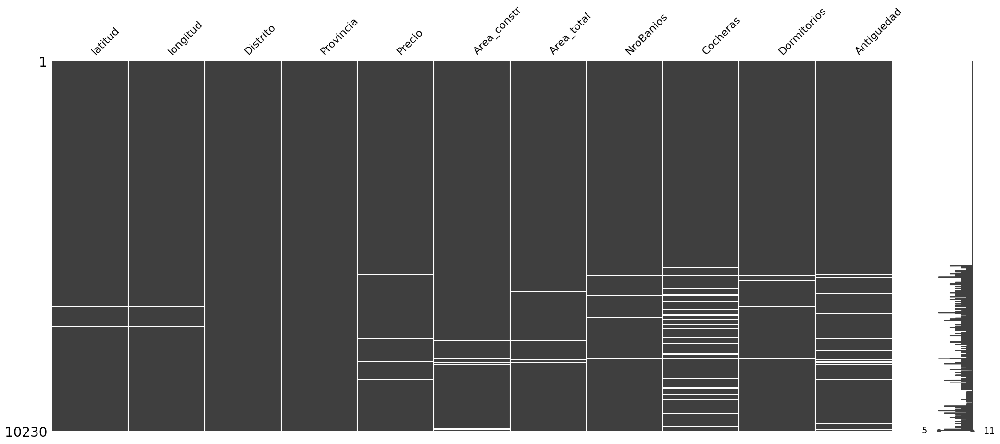

In [ ]:
ms.matrix(data_casas_filtrado_3)

In [ ]:
#IMPUTACION DE DATOS
from sklearn.compose import ColumnTransformer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, IterativeImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder

In [ ]:
num_cols = data_casas_filtrado_3.select_dtypes(include=['float64', 'int64']).columns

In [ ]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor

# Crear una copia para imputar
data_imputed = data_casas_filtrado_3.copy()

# Aplicar imputación solo a columnas numéricas
imputer = IterativeImputer(estimator=RandomForestRegressor(n_estimators=10, random_state=0),
                           max_iter=10, random_state=0)

data_imputed[num_cols] = imputer.fit_transform(data_casas_filtrado_3[num_cols])

/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


<Axes: >

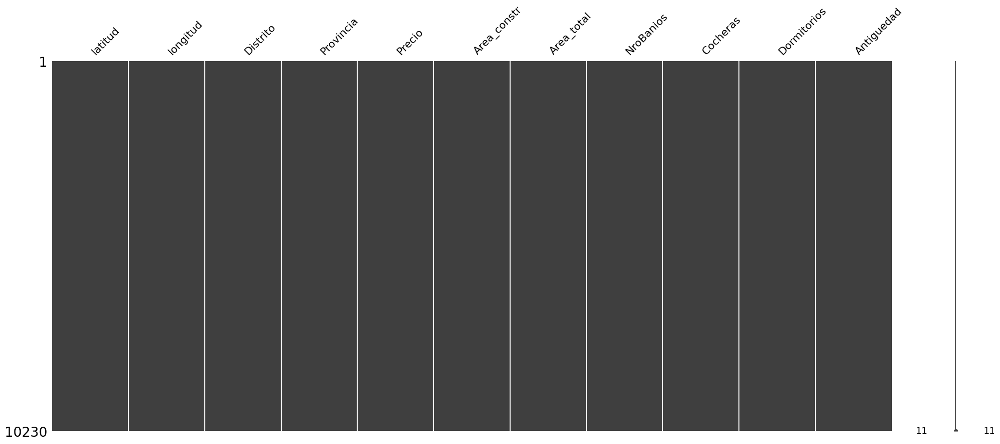

In [ ]:
ms.matrix(data_imputed)

IndexError: index 4 is out of bounds for axis 0 with size 4

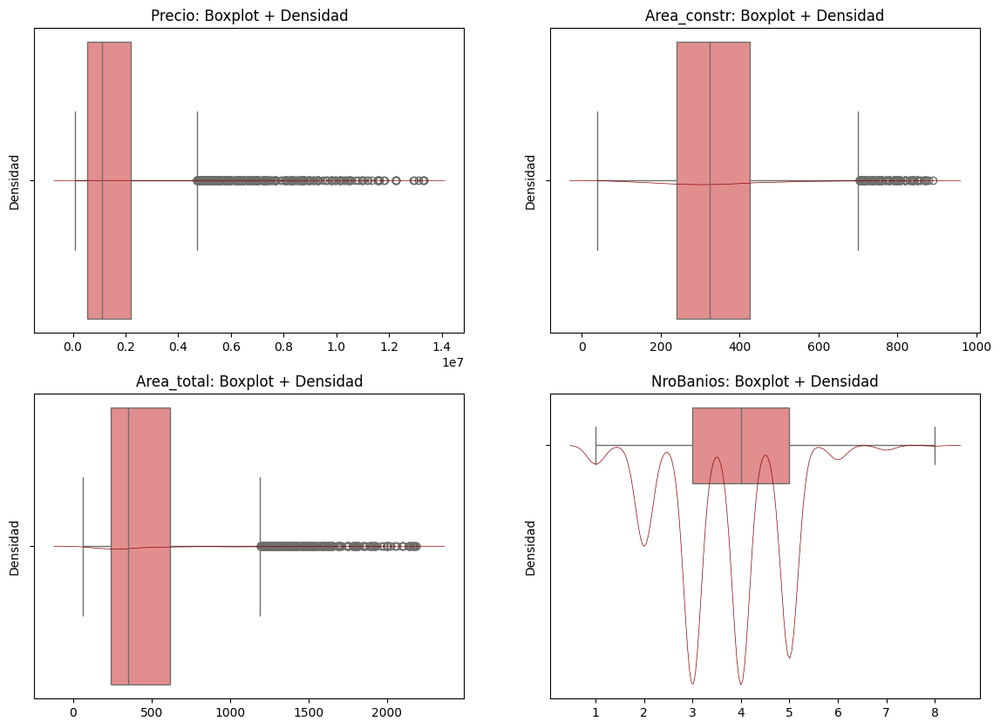

In [ ]:
#GRAFICO DE LA DISTRIBUCION DE LOS DATOS
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
sns.set(style="whitegrid")

# Lista de variables y ejes
variables = ['Precio', 'Area_constr', 'Area_total', 'NroBanios', 'Dormitorios']
ejes = axes.flatten()

# Graficar para cada variable
for i, var in enumerate(variables):
    sns.boxplot(x=data_imputed[var], ax=ejes[i], color='lightcoral', width=0.2)
    sns.kdeplot(x=data_imputed[var], ax=ejes[i], color='darkred', linewidth=0.5)
    ejes[i].set_title(f'{var}: Boxplot + Densidad')
    ejes[i].set_xlabel('')
    ejes[i].set_ylabel('Densidad')

plt.tight_layout()
plt.show()

In [ ]:
data_imputed.head(5)

In [ ]:
#VER QUE VARIBLES TIENEN CORRELACION CON EL PRECIO
print(data_imputed.corr(numeric_only=True)['Precio'].sort_values(ascending=False))

Precio         1.000000
latitud        0.555581
longitud       0.554577
Area_constr    0.499696
Area_total     0.464613
Cocheras       0.416093
Antiguedad     0.269375
NroBanios      0.147696
Dormitorios    0.028823
Name: Precio, dtype: float64


In [ ]:
data_imputed.shape

(10230, 11)

In [ ]:
data_imputed=pd.read_csv('drive/MyDrive/Colab Notebooks/PROYECTO/data_completa.csv')


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Supongamos que tienes un DataFrame llamado
data_imputed=pd.read_csv('data_completa.csv')

In [ ]:
# Diccionario que asigna los distritos a sus respectivas zonas
zonas = {
    'Ventanilla': 1, 'Puente Piedra': 1, 'Comas': 1, 'Carabayllo': 1,'Ancón':1,
    'Independencia': 2, 'Los Olivos': 2, 'San Martín de Porres': 2,
    'San Juan de Lurigancho': 3,
    'Cercado de Lima': 4, 'Rímac': 4, 'Breña': 4, 'La Victoria': 4,
    'Ate': 5, 'Chaclacayo': 5, 'Lurigancho': 5, 'Santa Anita': 5, 'San Luis': 5, 'El Agustino': 5,'Cieneguilla':5,
    'Jesús María': 6, 'Lince': 6, 'Pueblo Libre': 6, 'San Miguel': 6,'Magdalena del Mar':6,
    'Miraflores': 7, 'San Isidro': 7, 'San Borja': 7, 'Santiago de Surco': 7, 'La Molina': 7,
    'Surquillo': 8, 'Barranco': 8, 'Chorrillos': 8, 'San Juan de Miraflores': 8,
    'Villa El Salvador': 9, 'Villa María del Triunfo': 9, 'Lurín': 9, 'Pachacamac': 9,'San Bartolo':9,'Pucusana':9,'Punta Negra':9,'Punta Hermosa':9
}


# Crear una nueva columna 'Zona' en tu DataFrame asignando la zona correspondiente
data_imputed['Zona'] = data_imputed['Distrito'].map(zonas)




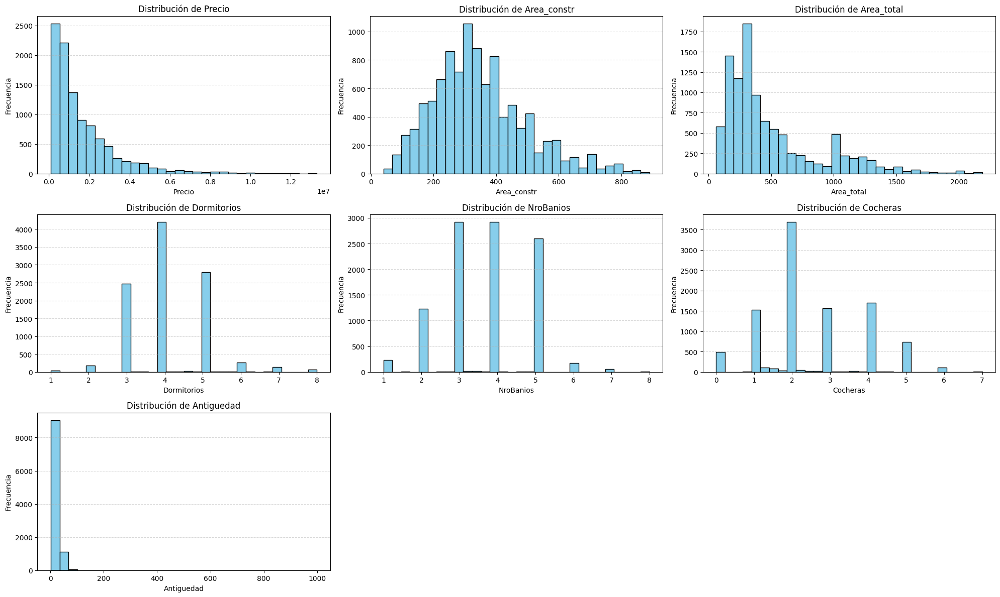

In [ ]:
# es imprtante recordar que para que una clasterizacion se muy buena las Variables deven tener una districucion normal o casi  normal
#devemos verivicar que todos tenga una distribucion(casi normal) normal

# Seleccionar solo las columnas numéricas relevantes
columnas_numericas = ['Precio', 'Area_constr', 'Area_total', 'Dormitorios', 'NroBanios', 'Cocheras', 'Antiguedad']


# Crear subgráficos (uno por variable)
plt.figure(figsize=(20, 12))
for i, col in enumerate(columnas_numericas, 1):
    plt.subplot(3, 3, i)
    plt.hist(data_imputed[col].dropna(), bins=30, color='skyblue', edgecolor='black')
    plt.title(f'Distribución de {col}')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.grid(axis='y', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

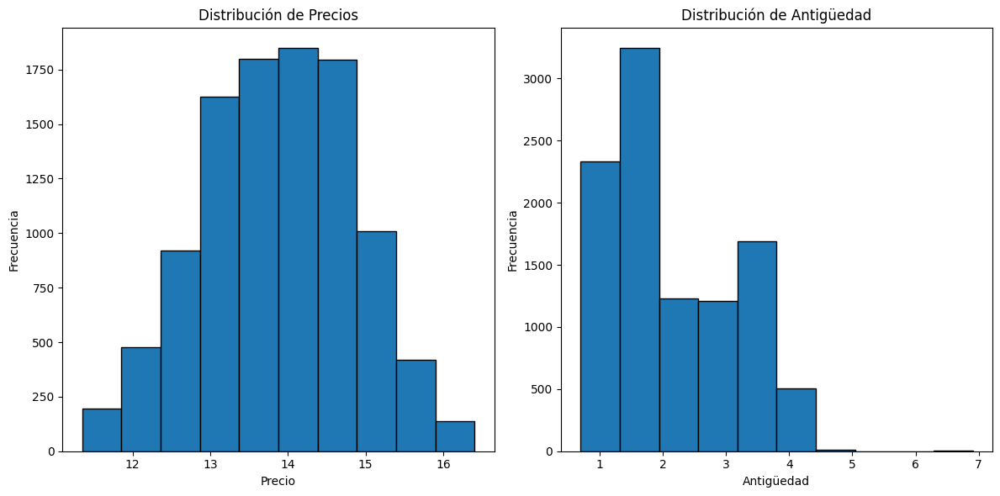

In [ ]:
# Aplicamos la transformación logarítmica a las columnas sesgadas como precio
# Sin embargo consideramos  aplicar transformaciones iguales para variables que se correlacionan  comoarea total y area contruidad
#(iniciamente aplicamos log pero normalizo una varibble y la que estaba normal  la sesgo a la derecha ) Po
# Transformación logarítmica de las columnas po
columnas_log = ['Precio', 'Antiguedad']
data_imputed[columnas_log] = np.log1p(data_imputed[columnas_log])

# Crear una figura con dos subgráficos
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Graficar la distribución de 'Precio'
axes[0].hist(data_imputed['Precio'], bins=10, edgecolor='black')
axes[0].set_title('Distribución de Precios')
axes[0].set_xlabel('Precio')
axes[0].set_ylabel('Frecuencia')

# Graficar la distribución de 'Antiguedad'
axes[1].hist(data_imputed['Antiguedad'], bins=10, edgecolor='black')
axes[1].set_title('Distribución de Antigüedad')
axes[1].set_xlabel('Antigüedad')
axes[1].set_ylabel('Frecuencia')

# Ajustar el espacio entre los subgráficos
plt.tight_layout()

# Mostrar los gráficos
plt.show()

In [ ]:
pip install scikit-learn

CLUSTERING

In [ ]:
from sklearn.preprocessing import StandardScaler

# 1. Seleccionar las características numéricas para escalar (incluyendo las transformadas)
features_clustering = ['latitud','longitud','Area_constr', 'Area_total', 'NroBanios', 'Cocheras', 'Dormitorios','Precio','Zona']#quitamos la varible precio y genero 4 clauters
data_clustering_numerical = data_imputed[features_clustering].copy()

# 2. Estandarizar las características numéricas
scaler_clean = StandardScaler()
scaled_features_clean = scaler_clean.fit_transform(data_clustering_numerical)
scaled_df_clean = pd.DataFrame(scaled_features_clean, columns=features_clustering)

# Mostrar las primeras filas del DataFrame final
print("\nPrimeras filas de los datos escalados :\n", scaled_df_clean.shape)


Primeras filas de los datos escalados :
 (10230, 9)


In [ ]:
scaled_df_clean.head()

,latitud,longitud,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Precio,Zona
0,-0.898775,-0.900064,0.700946,0.258334,0.253781,0.369544,-1.148073,-0.187437,0.272923
1,-0.892760,-0.899324,0.029648,-0.824492,1.134700,-1.126472,0.927656,-2.010171,-2.342533
2,-0.897769,-0.899818,1.875717,2.642109,1.134700,1.117552,-0.110208,0.623829,0.272923
3,-0.901820,-0.900621,-0.373131,-0.406422,0.253781,-0.378464,0.927656,-0.603818,0.272923
4,-0.899286,-0.900812,-0.306001,-0.884216,1.134700,-0.378464,0.927656,-1.055613,0.272923


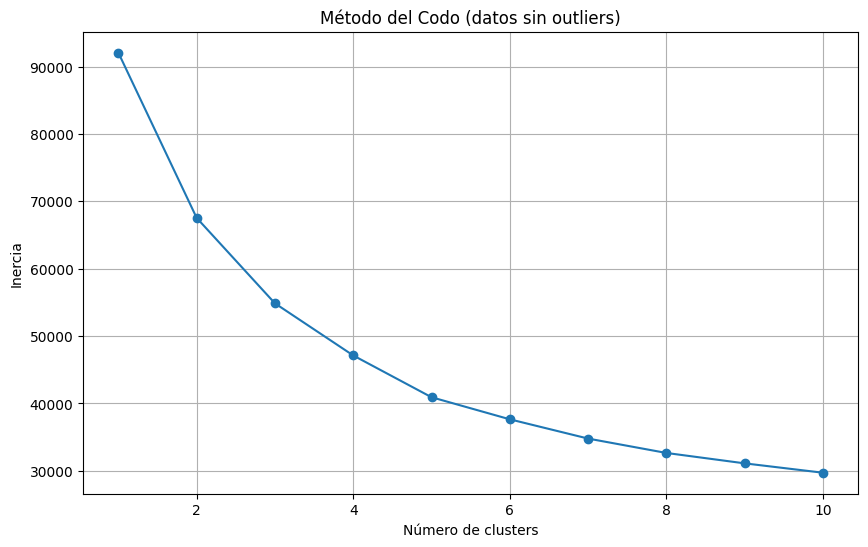

In [ ]:
from sklearn.cluster import KMeans


# Método del Codo
inertia = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42, n_init=10)
    kmeans.fit(scaled_df_clean)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Método del Codo (datos sin outliers)')
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.grid(True)
plt.show()

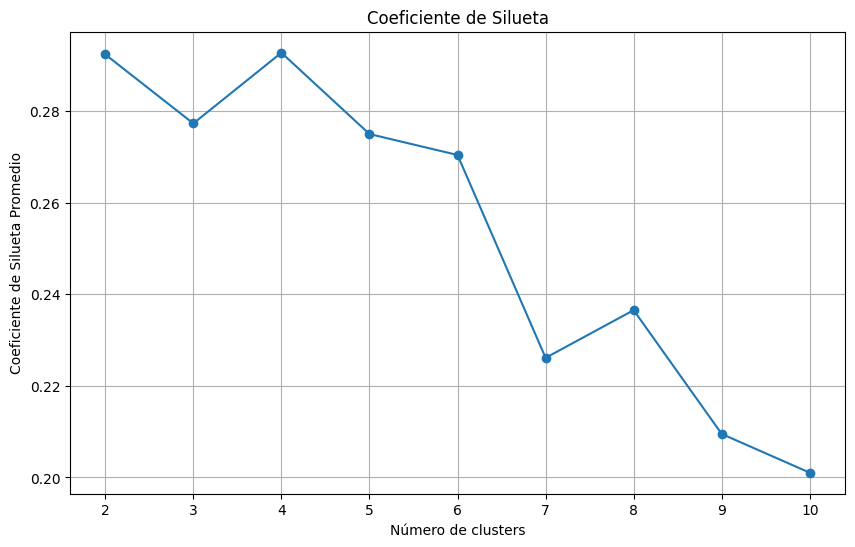


El número óptimo según el coeficiente de silueta es: 4


In [ ]:
# el coeficineete de sulueta ,es una metrica que nos permitira evaluar la calidad de los clausters,midiemdo que tan bien cada punto de dato se ajusta a su clauster asignado en comparcioncon otros clausters

from sklearn.metrics import silhouette_score
# Coeficiente de Silueta
silhouette_scores = []
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, random_state=42, n_init=10)
    clusters = kmeans.fit_predict(scaled_df_clean)
    silhouette_avg = silhouette_score(scaled_df_clean, clusters)
    silhouette_scores.append(silhouette_avg)

plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Coeficiente de Silueta')
plt.xlabel('Número de clusters')
plt.ylabel('Coeficiente de Silueta Promedio')
plt.grid(True)
plt.show()

best_k_clean = np.argmax(silhouette_scores) + 2
print(f"\nEl número óptimo según el coeficiente de silueta es: {best_k_clean}")

In [ ]:
from sklearn.cluster import KMeans
import joblib


n_clusters_optimal_clean = 2

kmeans_clean = KMeans(n_clusters=n_clusters_optimal_clean, random_state=42, n_init=10)
clusters_clean = kmeans_clean.fit_predict(scaled_df_clean)

# Guardar el modelo
joblib.dump(kmeans_clean, 'modelo_kmeans.pkl')

scaled_df_clean['Cluster'] = clusters_clean

print("\nDistribución de las viviendas en los clusters:")
print(scaled_df_clean['Cluster'].value_counts())

print("\nCaracterísticas promedio de cada cluster :")
print(
   scaled_df_clean.groupby('Cluster')[features_clustering + ['Precio']].mean())


Distribución de las viviendas en los clusters:
Cluster
1    5647
0    4583
Name: count, dtype: int64

Características promedio de cada cluster :
          latitud  longitud  Area_constr  Area_total  NroBanios  Cocheras  \
Cluster                                                                     
0        1.109323  1.109436    -0.044270   -0.022880  -0.130479  0.051930   
1       -0.900306 -0.900397     0.035929    0.018569   0.105895 -0.042145   

         Dormitorios    Precio      Zona    Precio  
Cluster                                             
0           0.066272  0.682560 -0.001149  0.682560  
1          -0.053785 -0.553953  0.000933 -0.553953  


# Analisis de clauster

**Clúster 0**:
*Tiende agrupar viviendas con una ubicación geográfica con valores ligeramente
más altos de latitud y longitud, un poco más pequeñas, con ligeramente menos baños pero un poco más cocheras y dormitorios, y son más caras, ubicadas en zonas con valores numéricos más bajos*

---


**Clúster 1**:
*Tiende a agrupar viviendas con una ubicación geográfica con valores ligeramente más bajos de latitud y longitud, un poco más grandes, con ligeramente más baños pero un poco menos cocheras y dormitorios, y son más económicas, ubicadas en zonas con valores numéricos más altos*

In [ ]:
scaled_df_clean['Cluster']

,Cluster
0,1
1,1
2,1
3,1
4,1
...,...
10225,0
10226,0
10227,0
10228,0


In [ ]:
#Estamos dividiedo  los clausters en distintos df
train_0 = scaled_df_clean[scaled_df_clean['Cluster'] == 0].copy()
train_1 = scaled_df_clean[scaled_df_clean['Cluster'] == 1].copy()

In [ ]:
train_0.head(6)

,latitud,longitud,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Precio,Zona,Cluster
5647,1.114743,1.105106,-0.574520,-0.520677,-0.627139,0.369544,-1.148073,0.811059,0.272923,0
5648,1.115908,1.105468,-0.769197,-0.699850,-1.508059,0.369544,-0.110208,0.516801,0.272923,0
5649,1.119734,1.105400,-1.245818,-0.884216,-0.627139,-1.126472,1.965520,-0.261400,0.926786,0
5650,1.103476,1.106577,-1.427069,-0.951730,1.134700,1.865560,1.861734,-0.628479,-3.650260,0
5651,1.113918,1.105690,-0.185168,-0.780348,1.134700,0.369544,-0.110208,0.350285,0.272923,0
5652,1.113676,1.104477,-0.319427,-0.520677,-0.627139,-0.154062,-1.148073,0.114929,0.272923,0


In [ ]:
# Desescalaremos los valore que realizamos antes de  clausterizacion
original_train_0 = scaler_clean.inverse_transform(train_0.drop('Cluster', axis=1))
train_0_original_df = pd.DataFrame(original_train_0, columns=features_clustering)

train_0_original_df['Precio'] = np.expm1(train_0_original_df['Precio'])

print(train_0_original_df.head())

     latitud   longitud  Area_constr  Area_total  NroBanios  Cocheras  \
0  12.093962  76.949149        260.0       300.0        3.0       3.0   
1  12.107949  76.976947        231.0       231.0        2.0       3.0   
2  12.153873  76.971737        160.0       160.0        3.0       1.0   
3  11.958706  77.062021        133.0       134.0        5.0       5.0   
4  12.084065  76.993992        318.0       200.0        5.0       3.0   

   Dormitorios     Precio  Zona  
0          3.0  2340000.0   7.0  
1          4.0  1757000.0   7.0  
2          6.0   823500.0   8.0  
3          5.9   576000.0   1.0  
4          4.0  1494000.0   7.0  


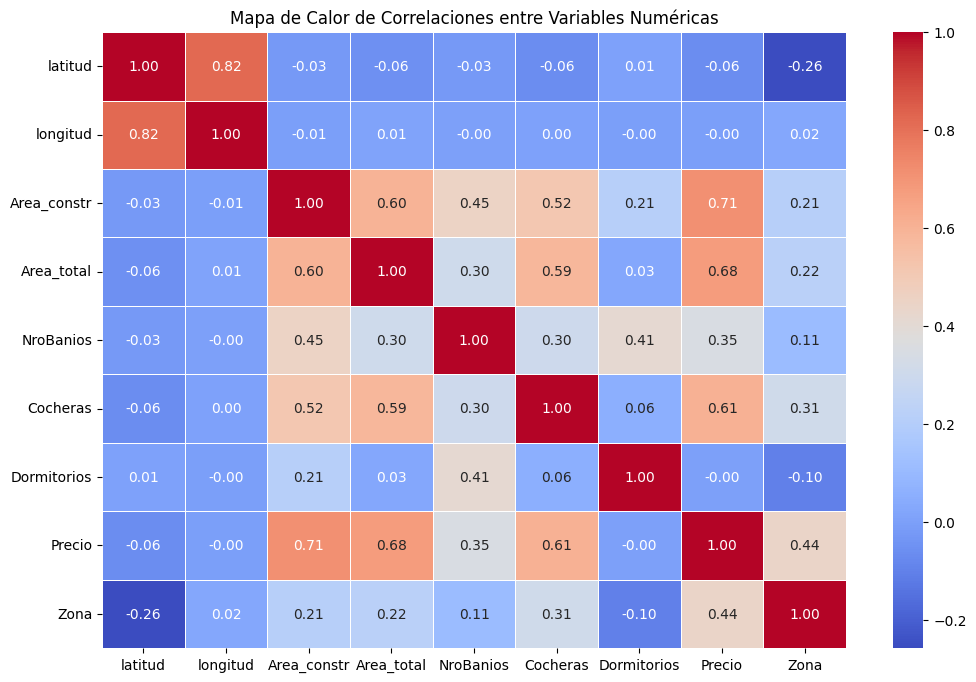

In [ ]:
#Berificaremos  las correlacion de las varibles
import matplotlib.pyplot as plt
import seaborn as sns

# Filtrar solo las columnas numéricas
variables_numericas = train_0.select_dtypes(include=['float64', 'int64'])

# Calcular la matriz de correlación
correlacion = variables_numericas.corr()

# Crear el mapa de calor
plt.figure(figsize=(12,8))
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Mapa de Calor de Correlaciones entre Variables Numéricas')
plt.show()


In [ ]:

train_0_original_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4583 entries, 0 to 4582
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   latitud      4583 non-null   float64
 1   longitud     4583 non-null   float64
 2   Area_constr  4583 non-null   float64
 3   Area_total   4583 non-null   float64
 4   NroBanios    4583 non-null   float64
 5   Cocheras     4583 non-null   float64
 6   Dormitorios  4583 non-null   float64
 7   Precio       4583 non-null   float64
 8   Zona         4583 non-null   float64
dtypes: float64(9)
memory usage: 322.4 KB


In [ ]:
train_0_original_df['Zona'] = train_0_original_df['Zona'].round().astype(int)
columnas_a_convertir=['NroBanios','Cocheras','Dormitorios','Zona']
train_0_original_df[columnas_a_convertir] = train_0_original_df[columnas_a_convertir].astype(int)

In [ ]:
train_0_original_df.describe()

/usr/local/lib/python3.11/dist-packages/numpy/lib/_function_base_impl.py:4779: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


,latitud,longitud,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Precio,Zona
count,5647.000000,5647.000000,5647.000000,5647.000000,5647.000000,5647.000000,5647.000000,5647.0,5647.000000
mean,-12.095605,-76.955042,350.935693,507.665440,3.832123,2.449619,4.054365,inf,6.584027
std,0.188607,1.028729,145.697928,398.065917,1.032148,1.396025,0.804952,NaN,1.498487
min,-17.092263,-77.133416,40.000000,60.000000,1.000000,0.000000,1.000000,inf,1.000000
25%,-12.115216,-77.012417,249.000000,228.000000,3.000000,2.000000,3.000000,NaN,7.000000
50%,-12.089614,-76.970344,330.000000,347.000000,4.000000,2.000000,4.000000,NaN,7.000000
75%,-12.076760,-76.928234,435.000000,641.050000,5.000000,4.000000,5.000000,NaN,7.000000
max,0.000000,0.000000,880.000000,2185.000000,5.000000,6.000000,5.000000,inf,9.000000



```
# Esto tiene formato de código
```el valor de este calsueter para precio va desde precio(mini(85000)) y un maximo de precio por propieda de (1,100,000)
con una mediana  de Lo pronunciarías como:

Ochocientos siete mil novecientos sesenta ('8.079618".)


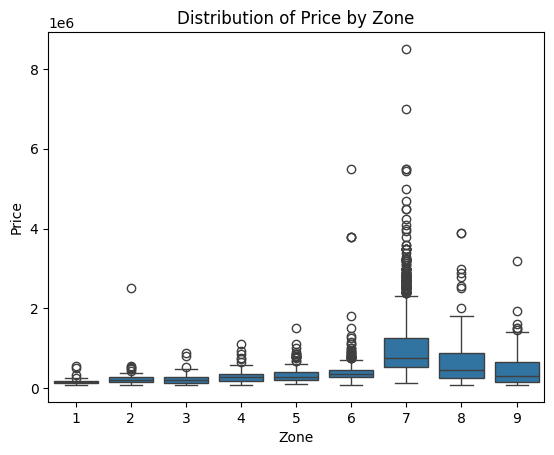

In [ ]:
# prompt: Con DataFrame train_0_original_df: distribucion de precio por zaonas 1boxplo}

import seaborn as sns
import matplotlib.pyplot as plt

# Create the boxplot
sns.boxplot(x='Zona', y='Precio', data=train_0_original_df)

# Customize the plot (optional)
plt.title('Distribution of Price by Zone')
plt.xlabel('Zone')
plt.ylabel('Price')

# Show the plot
plt.show()


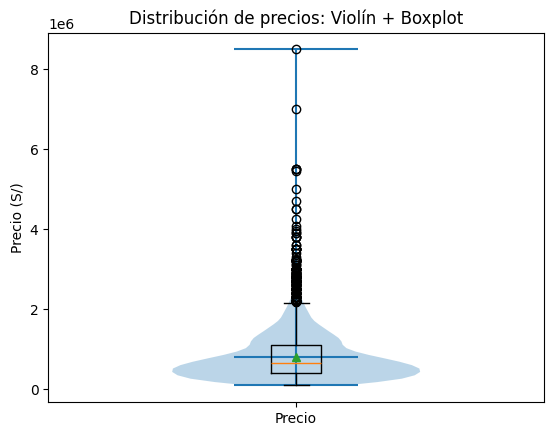

In [ ]:
import matplotlib.pyplot as plt

import matplotlib.pyplot as plt

# Si tu DataFrame se llama train_0_original_df, lo usamos directamente:
df = train_0_original_df

# Preparamos los datos
data = df['Precio'].dropna()

# Creamos figura y eje
fig, ax = plt.subplots()

# Diagrama de violín
ax.violinplot(data, showmeans=True)

# Boxplot superpuesto (ancho pequeño y posición centrada)
ax.boxplot(data, widths=0.1, positions=[1], showmeans=True)

# Etiquetas y título
ax.set_title('Distribución de precios: Violín + Boxplot')
ax.set_ylabel('Precio (S/)')
ax.set_xticks([1])
ax.set_xticklabels(['Precio'])

# Mostrar gráfico
plt.show()



In [ ]:
#Este mapa divide las propiedades del clúster en tres grupos de precio usando los cuartiles:
#las más accesibles (bajo Q1), las de precio estándar (entre Q1 y Q3), y las más costosas (sobre Q3).
#Esto permite ver rápidamente dónde se ubican las opciones económicas, promedio y de alto valor dentro del área analizada.

In [ ]:
import folium
import pandas as pd
from ipywidgets import interact, widgets
from IPython.display import display

# Carga tu DataFrame
df = train_0_original_df.copy()

# Widgets
zonas = ['Todas'] + sorted(df['Zona'].unique().tolist())
zona_widget = widgets.Dropdown(options=zonas, description='Zona:')
precio_min, precio_max = int(df['Precio'].min()), int(df['Precio'].max())
precio_widget = widgets.IntRangeSlider(
    value=[precio_min, precio_max],
    min=precio_min,
    max=precio_max,
    step=10000,
    description='Precio:',
    continuous_update=False
)

def mostrar_mapa(zona, precio):
    # Filtrado
    df_filtrado = df[(df['Precio'] >= precio[0]) & (df['Precio'] <= precio[1])]
    if zona != 'Todas':
        df_filtrado = df_filtrado[df_filtrado['Zona'] == zona]

    # Mapa base
    m = folium.Map(location=[-12.0464, -77.0428], zoom_start=12)

    # Marcadores
    for _, row in df_filtrado.iterrows():
        color = (
            'green'  if row['Precio'] < 385000 else
            'orange' if row['Precio'] < 1100000 else
            'red'
        )
        popup = (f"<b>Distrito:</b> {row['Zona']}<br>"
                 f"<b>Precio:</b> S/{row['Precio']}<br>"
                 f"<b>Área Total:</b> {row['Area_total']} m²")
        folium.CircleMarker(
            [row['latitud'], row['longitud']],
            radius=5, color=color, fill=True, fill_color=color,
            fill_opacity=0.6,
            popup=folium.Popup(popup, max_width=300)
        ).add_to(m)

    # Leyenda
    legend_html = '''
     <div style="
       position: fixed;
       bottom: 50px; left: 50px; width: 160px; height: 110px;
       background-color: white;
       border:2px solid grey; z-index:9999; font-size:14px;
       padding: 8px;
     ">
       <b>Rango de Precios</b><br>
       <i style="background:green; width:12px; height:12px; float:left; margin-right:6px"></i>< 385 000<br>
       <i style="background:orange; width:12px; height:12px; float:left; margin-right:6px"></i>385 000–1 100 000<br>
       <i style="background:red; width:12px; height:12px; float:left; margin-right:6px"></i>>1 100 000
     </div>
    '''
    m.get_root().html.add_child(folium.Element(legend_html))

    # Muestra y guarda
    display(m)
    m.save('mapa_interactivo.html')

# Lanzamos el interactivo
interact(mostrar_mapa, zona=zona_widget, precio=precio_widget)


interactive(children=(Dropdown(description='Zona:', options=('Todas', 1.0, 2.0, 3.0000000000000004, 4.0, 5.0, …

<function __main__.mostrar_mapa(zona, precio)>

* Muy Baja: Propiedades donde la proporción del área construida respecto al área total es muy baja (mucha área libre).
* Baja: Propiedades con una baja proporción de área construida.
* Media: Propiedades con una proporción moderada de área construida.
* Alta: Propiedades donde la proporción del área construida es alta (poco espacio libre).
* Muy Alta: Propiedades con una proporción muy alta de área construida (casi todo el terreno está construido).

In [ ]:
#
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# 2. Cálculos adicionales
train_0_original_df['proporcion_construida'] = train_0_original_df['Area_constr'] / train_0_original_df['Area_total']
train_0_original_df['Precio_m2'] = train_0_original_df['Precio'] / train_0_original_df['Area_total']
train_0_original_df['categoria_densidad'] = pd.qcut(
    train_0_original_df['proporcion_construida'],
    q=5,
    labels=['Muy Baja', 'Baja', 'Media', 'Alta', 'Muy Alta']
)

In [ ]:
# 3. Crear mapa con MarkerCluster
mapa = folium.Map(
    location=[train_0_original_df['latitud'].mean(), train_0_original_df['longitud'].mean()],
    zoom_start=12
)
cluster = MarkerCluster().add_to(mapa)

colores = {
    'Muy Baja': 'blue',
    'Baja': 'lightblue',
    'Media': 'orange',
    'Alta': 'red',
    'Muy Alta': 'darkred'
}

for _, fila in train_0_original_df.iterrows():
    folium.CircleMarker(
        location=[fila['latitud'], fila['longitud']],
        radius=4,
        color=colores[fila['categoria_densidad']],
        fill=True,
        fill_color=colores[fila['categoria_densidad']],
        fill_opacity=0.7,
        popup=(
            f"<b>Zona:</b> {fila['Zona']}<br>"
            f"<b>Área construida:</b> {fila['Area_constr']} m²<br>"
            f"<b>Área total:</b> {fila['Area_total']} m²<br>"
            f"<b>Proporción construida:</b> {fila['proporcion_construida']:.2f}<br>"
            f"<b>Precio:</b> S/{fila['Precio']}<br>"
            f"<b>Precio m²:</b> S/{fila['Precio_m2']:.0f}"
        )
    ).add_to(cluster)

# 4. Añadir leyenda
legend_html = '''
 <div style="
   position: fixed;
   bottom: 50px; left: 50px;
   background-color: white;
   border:2px solid grey; z-index:9999; font-size:14px;
   padding: 8px;
 ">
   <b>Densidad de construcción</b><br>
   <i style="background:blue; width:12px; height:12px; float:left; margin-right:6px"></i>Muy Baja<br>
   <i style="background:lightblue; width:12px; height:12px; float:left; margin-right:6px"></i>Baja<br>
   <i style="background:orange; width:12px; height:12px; float:left; margin-right:6px"></i>Media<br>
   <i style="background:red; width:12px; height:12px; float:left; margin-right:6px"></i>Alta<br>
   <i style="background:darkred; width:12px; height:12px; float:left; margin-right:6px"></i>Muy Alta
 </div>
'''
mapa.get_root().html.add_child(folium.Element(legend_html))

# 5. Mostrar y guardar el mapa
display(mapa)
mapa.save('mapa_densidad.html')

In [ ]:
# 6. Estadísticas resumen por categoría
resumen = (
    train_0_original_df
    .groupby('categoria_densidad')
    .agg(
        n_propiedades = ('Precio', 'count'),
        proporcion_construida = ('proporcion_construida', 'mean'),
        precio_m2_promedio = ('Precio_m2', 'mean')
    )
    .sort_index()
)
print("Resumen por categoría de densidad:")
print(resumen)



Resumen por categoría de densidad:
                    n_propiedades  proporcion_construida  precio_m2_promedio
categoria_densidad                                                          
Muy Baja                     1136               0.380946         1189.296464
Baja                         1123               0.657427         1655.142283
Media                        1659               0.940109         1747.825772
Alta                          620               1.113282         2236.288620
Muy Alta                     1109               1.794432         2406.365733


<ipython-input-62-308431b961a7>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby('categoria_densidad')


In [ ]:
import pandas as pd
import folium
from folium.plugins import HeatMap
from folium import FeatureGroup, LayerControl
from ipywidgets import interact, widgets
from IPython.display import display

# 1. Prepara tu DataFrame
df = train_0_original_df.copy()
assert {'latitud','longitud','categoria_densidad','Zona','Precio'}.issubset(df.columns), \
       "Verifica que existan estas columnas en tu DF"

# 2. Crear categoría económica según terciles de precio
df['categoria_economica'] = pd.qcut(df['Precio'], q=3, labels=['Bajo', 'Medio', 'Alto'])

# 3. Lista de zonas para el filtro
zonas = ['Todas'] + sorted(df['Zona'].unique().tolist())
zona_widget = widgets.Dropdown(options=zonas, description='Zona:')

def crear_mapa_por_zona(zona):
    # Filtrado por zona
    df_sub = df if zona == 'Todas' else df[df['Zona'] == zona]

    # Mapa base
    m = folium.Map(
        location=[df_sub['latitud'].mean(), df_sub['longitud'].mean()],
        zoom_start=12
    )

    # Colores por densidad
    colores_densidad = {
        'Muy Baja': 'blue',
        'Baja': 'lightblue',
        'Media': 'orange',
        'Alta': 'red',
        'Muy Alta': 'darkred'
    }
    # Capa HeatMap por densidad
    for cat, color in colores_densidad.items():
        pts = df_sub[df_sub['categoria_densidad'] == cat][['latitud','longitud']].values.tolist()
        if pts:
            fg = FeatureGroup(name=f"Densidad – {cat}", show=False)
            HeatMap(data=pts, gradient={"0.2": color, "0.8": color},
                    radius=15, blur=10, min_opacity=0.3).add_to(fg)
            m.add_child(fg)

    # Colores por categoría económica
    colores_economica = {
        'Bajo': 'green',
        'Medio': 'yellow',
        'Alto': 'purple'
    }
    # Capa HeatMap por precio económico
    for cat, color in colores_economica.items():
        pts = df_sub[df_sub['categoria_economica'] == cat][['latitud','longitud']].values.tolist()
        if pts:
            fg = FeatureGroup(name=f"Precio – {cat}", show=False)
            HeatMap(data=pts, gradient={"0.2": color, "0.8": color},
                    radius=15, blur=10, min_opacity=0.3).add_to(fg)
            m.add_child(fg)

    # Control de capas
    LayerControl(collapsed=False).add_to(m)

    # Leyenda combinada
    legend = '''
    <div style="
       position: fixed; bottom: 50px; left: 50px;
       background: white; padding: 8px; border:2px solid grey; z-index:9999;
       font-size:14px;
    ">
      <b>Densidad de construcción</b><br>
      <i style="background:blue; width:12px; height:12px; float:left; margin-right:6px"></i>Muy Baja<br>
      <i style="background:lightblue; width:12px; height:12px; float:left; margin-right:6px"></i>Baja<br>
      <i style="background:orange; width:12px; height:12px; float:left; margin-right:6px"></i>Media<br>
      <i style="background:red; width:12px; height:12px; float:left; margin-right:6px"></i>Alta<br>
      <i style="background:darkred; width:12px; height:12px; float:left; margin-right:6px"></i>Muy Alta<br>
      <b>Precio (económico)</b><br>
      <i style="background:green; width:12px; height:12px; float:left; margin-right:6px"></i>Bajo<br>
      <i style="background:yellow; width:12px; height:12px; float:left; margin-right:6px"></i>Medio<br>
      <i style="background:purple; width:12px; height:12px; float:left; margin-right:6px"></i>Alto
    </div>
    '''
    m.get_root().html.add_child(folium.Element(legend))

    # Mostrar y guardar
    display(m)
    m.save(f'mapa_mixed_{zona.replace(" ", "_")}.html')

# Ejecutar interactivo en Colab
interact(crear_mapa_por_zona, zona=zona_widget)


interactive(children=(Dropdown(description='Zona:', options=('Todas', 1, 2, 3, 4, 5, 6, 7, 8, 9), value='Todas…

<function __main__.crear_mapa_por_zona(zona)>

 #Densidad de construccion
 *Las categorías “Muy Baja” y “Media” concentran la mayoría de los inmuebles (1 136 y 1 659), mientras que “Alta” es la más escasa (620).
 *Esto sugiere que la mayor parte del mercado se concentra en zonas con construcción muy dispersa o moderada.




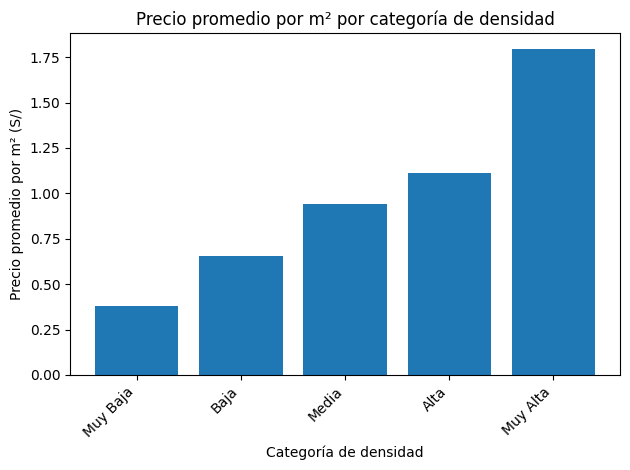

In [ ]:
labels = resumen.index.tolist()
values = resumen['proporcion_construida'].tolist()

fig, ax = plt.subplots()
ax.bar(labels, values)
ax.set_title('Precio promedio por m² por categoría de densidad')
ax.set_xlabel('Categoría de densidad')
ax.set_ylabel('Precio promedio por m² (S/)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

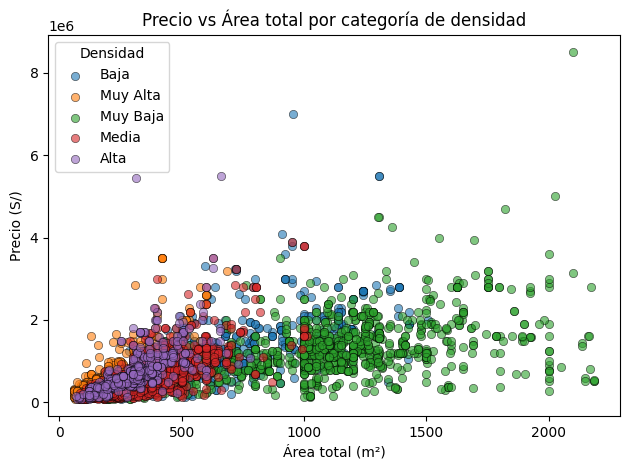

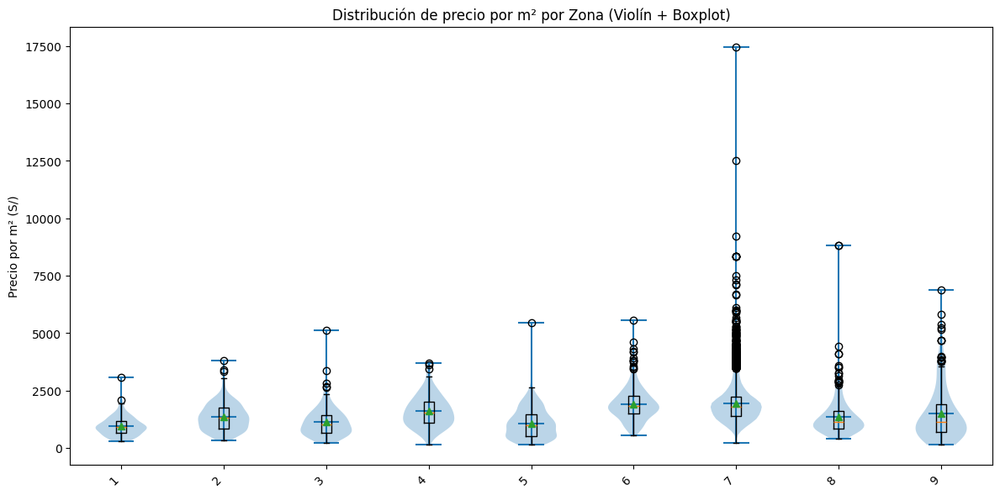

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Asegúrate de tener train_0_original_df cargado
df = train_0_original_df.copy()

# 1) Scatter: Precio vs Área total, coloreado por categoría de densidad
# Prepara el mapeo de colores
categorias = df['categoria_densidad'].unique()
colores = plt.cm.tab10(range(len(categorias)))
color_map = dict(zip(categorias, colores))

fig, ax = plt.subplots()
for cat, color in color_map.items():
    sub = df[df['categoria_densidad'] == cat]
    ax.scatter(sub['Area_total'], sub['Precio'], label=cat, color=color, alpha=0.6, edgecolor='k', linewidth=0.5)

ax.set_xlabel('Área total (m²)')
ax.set_ylabel('Precio (S/)')
ax.set_title('Precio vs Área total por categoría de densidad')
ax.legend(title='Densidad')
plt.tight_layout()
plt.show()

# 2) Violin + Boxplot: Distribución de Precio por m² por Zona
# Calcula Precio por m² si no existe
if 'Precio_m2' not in df.columns:
    df['Precio_m2'] = df['Precio'] / df['Area_total']

zonas = sorted(df['Zona'].unique())
data = [df[df['Zona'] == z]['Precio_m2'].dropna() for z in zonas]

fig, ax = plt.subplots(figsize=(12, 6))
# Diagrama de violín
parts = ax.violinplot(data, showmeans=True)
# Boxplot superpuesto
ax.boxplot(data, widths=0.1, positions=range(1, len(zonas) + 1), showmeans=True)

ax.set_xticks(range(1, len(zonas) + 1))
ax.set_xticklabels(zonas, rotation=45, ha='right')
ax.set_ylabel('Precio por m² (S/)')
ax.set_title('Distribución de precio por m² por Zona (Violín + Boxplot)')
plt.tight_layout()
plt.show()

In [ ]:
# 1. Seleccionar las características numéricas para escalar (incluyendo las transformadas)
features_clustering_new = ['latitud','longitud','Area_constr', 'Area_total', 'NroBanios', 'Cocheras', 'Dormitorios','Zona']#quitamos la varible precio y genero 4 clauters
data_clustering_numerical = data_imputed[features_clustering_new].copy()

# 2. Estandarizar las características numéricas
scaler_clean = StandardScaler()
scaled_features_clean = scaler_clean.fit_transform(data_clustering_numerical)
scaled_df_clean = pd.DataFrame(scaled_features_clean, columns=features_clustering_new)

# Mostrar las primeras filas del DataFrame final
print("\nPrimeras filas de los datos escalados :\n", scaled_df_clean.shape)



Primeras filas de los datos escalados :
 (10230, 8)


In [ ]:
#APLICAMOS LAS CLUSTERIZACION CON 2 CLUSTER

from sklearn.cluster import KMeans
import joblib


n_clusters_optimal_clean_new = 2

kmeans_clean = KMeans(n_clusters=n_clusters_optimal_clean_new, random_state=42, n_init=10)
clusters_clean = kmeans_clean.fit_predict(scaled_df_clean)

# Guardar el modelo
joblib.dump(kmeans_clean, 'modelo_kmeans.pkl')

scaled_df_clean['Cluster'] = clusters_clean

#Gauardamos el modelo scaler
joblib.dump(scaler_clean, 'scaler_clean.pkl')

print("\nDistribución de las viviendas en los clusters:")
print(scaled_df_clean['Cluster'].value_counts())

print("\nCaracterísticas promedio de cada cluster :")




Distribución de las viviendas en los clusters:
Cluster
0    5646
1    4584
Name: count, dtype: int64

Características promedio de cada cluster :


In [ ]:

train_0_new = scaled_df_clean[scaled_df_clean['Cluster'] == 0].copy()
train_1_new = scaled_df_clean[scaled_df_clean['Cluster'] == 1].copy()
scaled_df_clean['Cluster']

,Cluster
0,0
1,0
2,0
3,0
4,0
...,...
10225,1
10226,1
10227,1
10228,1


In [ ]:
# Desescalaremos los valore que realizamos antes de  clausterizacion C1
original_train_1 = scaler_clean.inverse_transform(train_1_new.drop('Cluster', axis=1))
train_1_original_df = pd.DataFrame(original_train_1, columns=features_clustering_new)



print(train_1_original_df.head())

     latitud   longitud  Area_constr  Area_total  NroBanios  Cocheras  \
0   0.000000   0.000000        232.0       192.0        3.0       1.0   
1  12.093962  76.949149        260.0       300.0        3.0       3.0   
2  12.107949  76.976947        231.0       231.0        2.0       3.0   
3  12.153873  76.971737        160.0       160.0        3.0       1.0   
4  11.958706  77.062021        133.0       134.0        5.0       5.0   

   Dormitorios  Zona  
0          4.0   7.0  
1          3.0   7.0  
2          4.0   7.0  
3          6.0   8.0  
4          5.9   1.0  


In [ ]:
train_1_original_df.head(4)

,latitud,longitud,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Zona
0,0.000000,0.000000,232.0,192.0,3.0,1.0,4.0,7.0
1,12.093962,76.949149,260.0,300.0,3.0,3.0,3.0,7.0
2,12.107949,76.976947,231.0,231.0,2.0,3.0,4.0,7.0
3,12.153873,76.971737,160.0,160.0,3.0,1.0,6.0,8.0


In [ ]:
# 1. Recuperar los índices del cluster 1
indices_cluster_1 = train_1_new.index

# 2. Extraer el precio original desde data_imputed
precios_cluster_1 = data_imputed.loc[indices_cluster_1, 'Precio'].values

# 3. Agregar Precio y opcionalmente Cluster
train_1_original_df['Precio'] = precios_cluster_1
train_1_original_df['Cluster'] = 1

In [ ]:
# Desescalar
original_train_0 = scaler_clean.inverse_transform(train_0_new.drop('Cluster', axis=1))
train_0_original_df = pd.DataFrame(original_train_0, columns=features_clustering_new)

# Recuperar índice y precios
indices_cluster_0 = train_0_new.index
precios_cluster_0 = data_imputed.loc[indices_cluster_0, 'Precio'].values

# Agregar Precio y Cluster
train_0_original_df['Precio'] = precios_cluster_0
train_0_original_df['Cluster'] = 0

In [ ]:
train_0_original_df.head(4)

,latitud,longitud,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Zona,Precio,Cluster
0,-12.077232,-76.929494,450.0,600.0,4.0,3.0,3.0,7.0,885000.0,0
1,-12.005022,-76.872657,350.0,183.0,5.0,1.0,5.0,3.0,150000.0,0
2,-12.065150,-76.910620,625.0,1518.0,5.0,4.0,4.0,7.0,1950000.0,0
3,-12.113779,-76.972217,290.0,344.0,4.0,2.0,5.0,7.0,590000.0,0


In [ ]:
train_1_original_df.head(4)


--- Entrenando modelo para cluster 0 ---


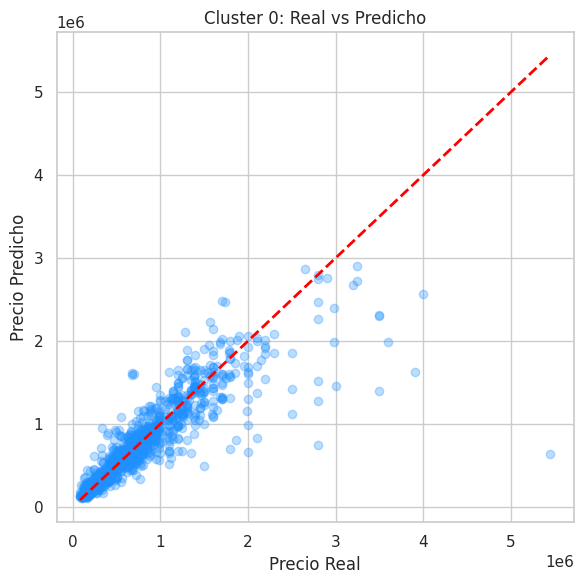

R²: 0.8745
MSE: 0.07

--- Entrenando modelo para cluster 1 ---


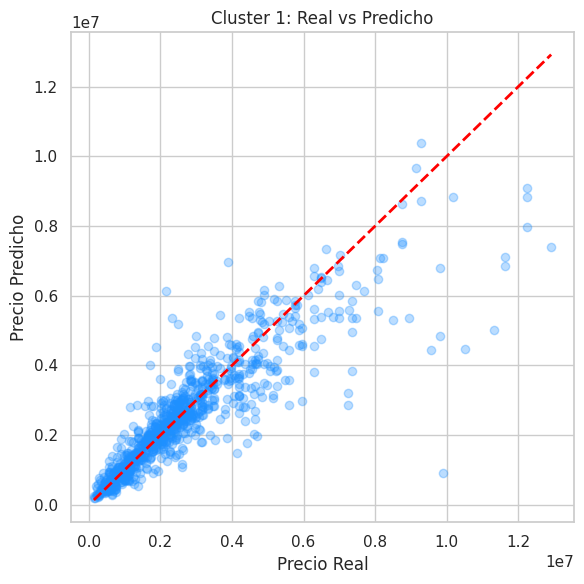

R²: 0.8522
MSE: 0.09


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np
# Diccionario con tus DataFrames por cluster
clusters = {
    0: train_0_original_df,
    1: train_1_original_df
}

modelos = {}  # Para guardar los modelos entrenados

for cluster_id, df in clusters.items():
    print(f"\n--- Entrenando modelo para cluster {cluster_id} ---")

    X = df.drop(columns=['Precio','Cluster'])
    y = np.log1p(df['Precio'])

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    modelo = RandomForestRegressor(
        n_estimators=300,       # más árboles
        max_depth=15,           # evita sobreajuste
        min_samples_split=5,    # controla tamaño de ramas
        min_samples_leaf=3,     # evita ramas muy pequeñas
        random_state=42,
        n_jobs=-1               # usa todos los núcleos
    )
    modelo.fit(X_train, y_train)

    y_pred = modelo.predict(X_test)

    #grafico
    y_test_real = np.expm1(y_test)
    y_pred_real = np.expm1(y_pred)

    plt.figure(figsize=(6, 6))
    plt.scatter(y_test_real, y_pred_real, alpha=0.3, color='dodgerblue')
    plt.plot([y_test_real.min(), y_test_real.max()],
             [y_test_real.min(), y_test_real.max()],
             color='red', linestyle='--', linewidth=2)
    plt.xlabel('Precio Real')
    plt.ylabel('Precio Predicho')
    plt.title(f'Cluster {cluster_id}: Real vs Predicho')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)

    print(f"R²: {r2:.4f}")
    print(f"MSE: {mse:.2f}")

    modelos[cluster_id] = modelo

In [ ]:
import pandas as pd

# Creamos un DataFrame con 5 casas de ejemplo
nuevas_casas = pd.DataFrame([
    {
        'latitud': -12.05,
        'longitud': -77.04,
        'Area_constr': 120,
        'Area_total': 150,
        'NroBanios': 2,
        'Cocheras': 1,
        'Dormitorios': 3,
        'Zona': 6
    },
    {
        'latitud': -12.10,
        'longitud': -77.06,
        'Area_constr': 180,
        'Area_total': 200,
        'NroBanios': 3,
        'Cocheras': 2,
        'Dormitorios': 4,
        'Zona': 7
    },
    {
        'latitud': -12.02,
        'longitud': -77.01,
        'Area_constr': 90,
        'Area_total': 110,
        'NroBanios': 1,
        'Cocheras': 0,
        'Dormitorios': 2,
        'Zona': 2
    },
    {
        'latitud': -12.08,
        'longitud': -77.05,
        'Area_constr': 250,
        'Area_total': 270,
        'NroBanios': 4,
        'Cocheras': 3,
        'Dormitorios': 5,
        'Zona': 4
    },
    {
        'latitud': -12.12,
        'longitud': -77.10,
        'Area_constr': 160,
        'Area_total': 190,
        'NroBanios': 2,
        'Cocheras': 2,
        'Dormitorios': 3,
        'Zona': 3


    }
])

In [ ]:
print(nuevas_casas[columnas_cluster].isna().sum())

latitud        0
longitud       0
Area_constr    0
Area_total     0
NroBanios      0
Cocheras       0
Dormitorios    0
Zona           0
dtype: int64


In [ ]:
import joblib
import numpy as np

#
# Cargar el modelo de clustering y scaler
kmeans_clean1 = joblib.load('modelo_kmeans.pkl')
scaler_clean = joblib.load('scaler_clean.pkl')  # Si guardaste el scaler antes

# Seleccionar las mismas columnas que usaste para el clustering
columnas_cluster = ['latitud', 'longitud', 'Area_constr', 'Area_total', 'NroBanios', 'Cocheras', 'Dormitorios', 'Zona']
X_nuevas = nuevas_casas[columnas_cluster]

# Escalar las nuevas casas con el mismo scaler
X_nuevas_scaled = scaler_clean.transform(X_nuevas)

# Predecir a qué cluster pertenece cada nueva casa
nuevas_casas['Cluster'] = kmeans_clean1.predict(X_nuevas_scaled)

# Mostrar el resultado
print(nuevas_casas[['Cluster']].head())


   Cluster
0        0
1        0
2        0
3        0
4        0


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


In [ ]:
# Asegúrate de tener los modelos y columnas correctas
columnas_modelo = ['latitud','longitud','Area_constr', 'Area_total', 'NroBanios', 'Cocheras', 'Dormitorios','Zona']

# Crear una lista para almacenar resultados
predicciones = []

for cluster_id, grupo in nuevas_casas.groupby('Cluster'):
    modelo = modelos[cluster_id]
    X = grupo[columnas_modelo]

    y_pred_log = modelo.predict(X)
    y_pred = np.expm1(y_pred_log)  # revertir log1p

    # Guardamos las predicciones
    predicciones.extend(y_pred)

# Agregamos al DataFrame
nuevas_casas['Precio_Predicho'] = predicciones

In [ ]:
nuevas_casas

,latitud,longitud,Area_constr,Area_total,NroBanios,Cocheras,Dormitorios,Zona,Cluster,Precio_Predicho
0,-12.05,-77.04,120,150,2,1,3,6,0,176394.097356
1,-12.10,-77.06,180,200,3,2,4,7,0,392376.773791
2,-12.02,-77.01,90,110,1,0,2,2,0,134959.080537
3,-12.08,-77.05,250,270,4,3,5,4,0,376268.777949
4,-12.12,-77.10,160,190,2,2,3,3,0,299199.365867


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Cargar el archivo CSV filtrado
data=pd.read_csv('drive/MyDrive/Colab Notebooks/PROYECTO/data_completa_compare.csv')


# Calcular el promedio de antigüedad por distrito
promedio_antiguedad = data.groupby('Distrito')['Antiguedad'].mean().reset_index()

# Renombrar la columna para mayor claridad
promedio_antiguedad.rename(columns={'Antiguedad': 'Antiguedad_Promedio'}, inplace=True)

# Mostrar el resultado
print(promedio_antiguedad)

                   Distrito  Antiguedad_Promedio
0                     Ancón            15.833333
1                       Ate             9.300000
2                  Barranco            24.376812
3                     Breña            27.409677
4                Carabayllo             7.614583
5           Cercado de Lima            20.147525
6                Chaclacayo            11.295763
7                Chorrillos            11.626797
8               Cieneguilla             5.216364
9                     Comas            11.561947
10              El Agustino            19.720000
11            Independencia             6.800000
12              Jesús María            21.726923
13                La Molina             8.864191
14              La Victoria            22.512821
15                    Lince            19.372093
16               Los Olivos             9.671852
17                    Lurín            11.511628
18        Magdalena del Mar             4.228571
19               Mir

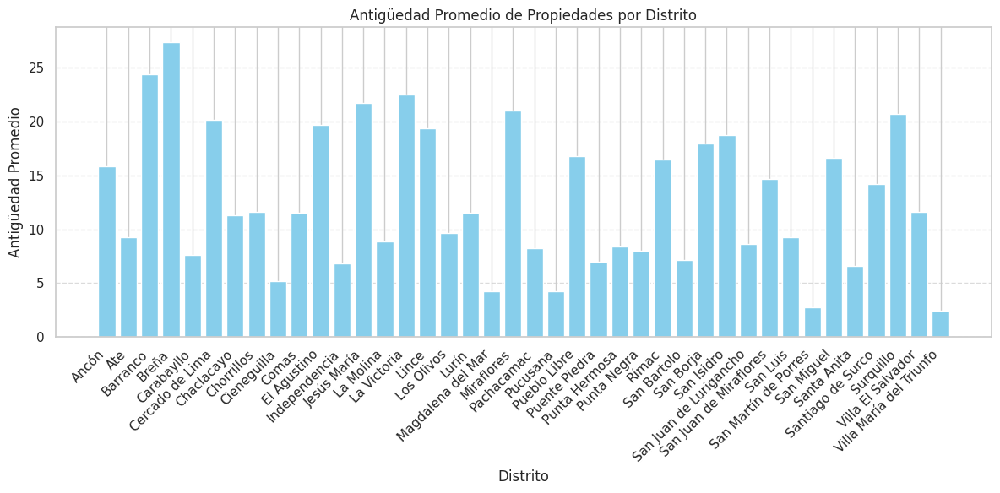

In [ ]:
# Asegúrate de tener el DataFrame `promedio_antiguedad` calculado
plt.figure(figsize=(12, 6))
plt.bar(promedio_antiguedad['Distrito'], promedio_antiguedad['Antiguedad_Promedio'], color='skyblue')
plt.xlabel('Distrito')
plt.ylabel('Antigüedad Promedio')
plt.title('Antigüedad Promedio de Propiedades por Distrito')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

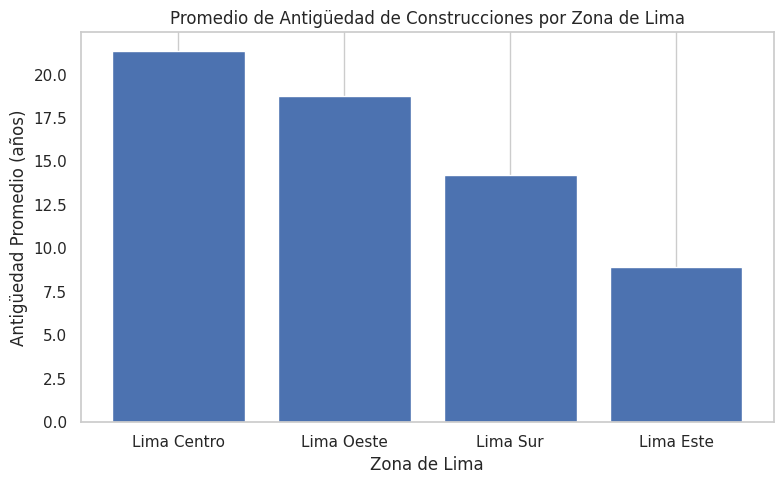

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt



# Clasificación de distritos por zona
zonas = {
    "Lima Centro": ["Cercado de Lima", "Breña", "La Victoria", "Jesús María", "Rímac", "Lince"],
    "Lima Este": ["Ate", "La Molina", "El Agustino", "Santa Anita", "San Juan de Lurigancho", "Chaclacayo", "Lurigancho"],
    "Lima Sur": ["Villa El Salvador", "Villa María del Triunfo", "Chorrillos", "San Juan de Miraflores", "Lurín", "Pachacamac", "Santiago de Surco", "San Borja"],
    "Lima Oeste": ["Miraflores", "San Isidro", "Barranco", "Magdalena del Mar", "Pueblo Libre", "San Miguel", "Callao"]
}

# Asignar zona a cada distrito
def asignar_zona(distrito):
    for zona, lista in zonas.items():
        if distrito in lista:
            return zona
    return "Otra"

data["Zona"] = data["Distrito"].apply(asignar_zona)

# Calcular promedio de antigüedad por zona
promedio_antiguedad = data.groupby("Zona")["Antiguedad"].mean().reset_index()
promedio_antiguedad = promedio_antiguedad.sort_values(by="Antiguedad", ascending=False)

# Filtrar zonas conocidas
zonas_filtradas = promedio_antiguedad[promedio_antiguedad["Zona"] != "Otra"]

# Gráfico de barras
plt.figure(figsize=(8, 5))
plt.bar(zonas_filtradas["Zona"], zonas_filtradas["Antiguedad"])
plt.title("Promedio de Antigüedad de Construcciones por Zona de Lima")
plt.xlabel("Zona de Lima")
plt.ylabel("Antigüedad Promedio (años)")
plt.grid(axis='y')
plt.tight_layout()
plt.show()